In [1]:
TRAIN = '/kaggle/input/garbage-classification/Garbage classification/train'
TEST = '/kaggle/input/garbage-classification/Garbage classification/test'
VAL = '/kaggle/input/garbage-classification/Garbage classification/val'

We want to use image embeddings for both EDA and classification, so let's add some code to get image embeddings using ResNeXt without fine-tuning.

In [2]:
import torch
import torchvision.models as models
import torchvision.transforms as transforms
import numpy as np


DEVICE = torch.device('cpu')
OUTPUT_SIZE = 2048

model = models.resnext50_32x4d(weights=models.ResNeXt50_32X4D_Weights.IMAGENET1K_V2)

extraction_layer = model._modules.get('avgpool')
model.to(DEVICE)
model.eval()

scaler = transforms.Resize((224, 224))
normalize = transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])
to_tensor = transforms.ToTensor()

def get_vec(arg, model, extraction_layer):
    image = normalize(to_tensor(scaler(arg))).unsqueeze(0).to(DEVICE)
    result = torch.zeros(1, OUTPUT_SIZE, 1, 1)
    def copy_data(m, i, o):
        result.copy_(o.data)
    hooked = extraction_layer.register_forward_hook(copy_data)
    with torch.no_grad():
        model(image)
    hooked.remove()
    return result

Downloading: "https://download.pytorch.org/models/resnext50_32x4d-1a0047aa.pth" to /root/.cache/torch/hub/checkpoints/resnext50_32x4d-1a0047aa.pth


100%|██████████| 95.8M/95.8M [00:00<00:00, 167MB/s]


Let's load up all of our data. This feels like it's going to take forever, but it only takes about fifteen minutes. Enough time for coffee, but not enough time for lunch.

In [3]:
import arrow
import base64
import pandas as pd
from glob import iglob
from io import BytesIO
from os.path import basename
from os.path import isdir
from PIL import Image

THUMBNAIL_SIZE = (48, 48)

def embed(model, filename: str):
    with Image.open(fp=filename, mode='r') as image:
        return get_vec(arg=image.convert('RGB'), model=model, extraction_layer=extraction_layer).numpy().reshape(OUTPUT_SIZE,)


# https://stackoverflow.com/a/952952
def flatten(arg):
    return [x for xs in arg for x in xs]

def png(filename: str) -> str:
    with Image.open(fp=filename, mode='r') as image:
        buffer = BytesIO()
        # our images are pretty big; let's shrink the hover images to thumbnail size
        image.resize(size=THUMBNAIL_SIZE).convert('RGB').save(buffer, format='png')
        return 'data:image/png;base64,' + base64.b64encode(buffer.getvalue()).decode()

def get_picture_from_glob(arg: str, tag: str,) -> list:
    time_get = arrow.now()
    result = [pd.Series(data=[tag, basename(input_file), embed(model=model, filename=input_file), png(filename=input_file)],
                        index=['tag', 'name', 'value', 'png'] )
        for index, input_file in enumerate(list(iglob(pathname=arg)))]
    print('encoded {} rows of {}  in {}'.format(len(result), tag, arrow.now() - time_get))
    return result

time_start = arrow.now()
train_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TRAIN + '/*') if isdir(folder)}
train_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in train_dict.items()]))
test_dict = {basename(folder) : folder + '/*.*' for folder in iglob(TEST + '/*') if isdir(folder)}
test_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in test_dict.items()]))
val_dict = {basename(folder) : folder + '/*.*' for folder in iglob(VAL + '/*') if isdir(folder)}
val_df = pd.DataFrame(data=flatten(arg=[get_picture_from_glob(arg=value, tag=key) for key, value in val_dict.items()]))
train_df = pd.concat(axis='index', objs=[train_df, val_df])
print('done in {}'.format(arrow.now() - time_start))

encoded 410 rows of metal  in 0:00:58.758482
encoded 501 rows of glass  in 0:01:10.988573
encoded 594 rows of paper  in 0:01:23.775448
encoded 137 rows of trash  in 0:00:19.292648
encoded 403 rows of cardboard  in 0:00:57.025661
encoded 482 rows of plastic  in 0:01:08.528965
encoded 410 rows of metal  in 0:00:58.090180
encoded 501 rows of glass  in 0:01:11.129015
encoded 594 rows of paper  in 0:01:23.252006
encoded 137 rows of trash  in 0:00:18.984762
encoded 403 rows of cardboard  in 0:00:56.433572
encoded 482 rows of plastic  in 0:01:07.375297
encoded 410 rows of metal  in 0:00:58.402461
encoded 501 rows of glass  in 0:01:09.941943
encoded 594 rows of paper  in 0:01:22.644257
encoded 137 rows of trash  in 0:00:19.077863
encoded 403 rows of cardboard  in 0:00:56.487357
encoded 482 rows of plastic  in 0:01:07.098360
done in 0:17:47.985015


Our classes are imbalanced, but how imbalanced are they?

In [4]:
train_df['tag'].value_counts(normalize=True).to_frame().T

tag,paper,glass,plastic,metal,cardboard,trash
proportion,0.235061,0.198259,0.19074,0.162248,0.159478,0.054214


We have some class imbalance, but our minority classes look like they are well-represented.

Next let's use TSNE to add x/y coordinated based on our image embeddings, for both our training data and our test data.

In [5]:
from sklearn.manifold import TSNE

train_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
train_df[['x', 'y']] = train_reducer.fit_transform(X=train_df['value'].apply(func=pd.Series))
test_reducer = TSNE(random_state=2025, verbose=True, n_jobs=1, perplexity=20.0, init='pca')
test_df[['x', 'y']] = test_reducer.fit_transform(X=test_df['value'].apply(func=pd.Series))

[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 5054 samples in 0.036s...
[t-SNE] Computed neighbors for 5054 samples in 2.144s...
[t-SNE] Computed conditional probabilities for sample 1000 / 5054
[t-SNE] Computed conditional probabilities for sample 2000 / 5054
[t-SNE] Computed conditional probabilities for sample 3000 / 5054
[t-SNE] Computed conditional probabilities for sample 4000 / 5054
[t-SNE] Computed conditional probabilities for sample 5000 / 5054
[t-SNE] Computed conditional probabilities for sample 5054 / 5054
[t-SNE] Mean sigma: 5.716304
[t-SNE] KL divergence after 250 iterations with early exaggeration: 82.740311
[t-SNE] KL divergence after 1000 iterations: 0.622734
[t-SNE] Computing 61 nearest neighbors...
[t-SNE] Indexed 2527 samples in 0.025s...
[t-SNE] Computed neighbors for 2527 samples in 0.549s...
[t-SNE] Computed conditional probabilities for sample 1000 / 2527
[t-SNE] Computed conditional probabilities for sample 2000 / 2527
[t-SNE] Computed conditional 

Let's plot.

In [6]:
from bokeh.models import ColumnDataSource
from bokeh.models import HoverTool

from bokeh.plotting import figure
from bokeh.plotting import output_notebook
from bokeh.plotting import show
from bokeh.palettes import Turbo256
from bokeh.transform import factor_cmap

output_notebook()

datasource = ColumnDataSource(train_df[['png', 'tag', 'x', 'y']].sample(n=min(len(train_df) - 1, 10000)))
factor_count = max(train_df['tag'].nunique(), 3)
indices = np.linspace(0, len(Turbo256)-1, factor_count, dtype=int)
palette = [Turbo256[index] for index in indices]
mapper = factor_cmap(field_name = 'tag', palette=palette, factors=train_df['tag'].unique().tolist(), start=0, end=factor_count-1, )

plot_figure = figure(title='TSNE projection: garbage', width=1000, height=800, tools=('pan, wheel_zoom, reset'))

plot_figure.add_tools(HoverTool(tooltips="""
<div>
    <div>
        <img src='@png' style='float: left; margin: 5px 5px 5px 5px'/>
    </div>
    <div>
        <span style='font-size: 18px'>@tag</span>
    </div>
</div>
"""))

plot_figure.scatter(x='x', y='y', source=datasource, line_alpha=0.6, fill_alpha=0.6, size=8, color=mapper)
show(plot_figure)

Loading BokehJS ...

What do we see? Our clusters are aligned with our classes, which is nice, and they are distinct but not separated. Let's build a model and see what we get.

In [7]:
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import f1_score

logreg = LogisticRegression(max_iter=1000, tol=1e-12).fit(train_df['value'].apply(func=pd.Series), train_df['tag'])
print('model fit in {} iterations'.format(logreg.n_iter_[0]))
print('accuracy: {:5.4f}'.format(accuracy_score(y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(func=pd.Series)))))
print('f1: {:5.4f}'.format(f1_score(average='weighted', y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(func=pd.Series)))))
print(classification_report(zero_division=0.0, y_true=test_df['tag'], y_pred=logreg.predict(X=test_df['value'].apply(func=pd.Series))))

model fit in 642 iterations
accuracy: 0.9988
f1: 0.9988
              precision    recall  f1-score   support

   cardboard       1.00      1.00      1.00       403
       glass       1.00      1.00      1.00       501
       metal       1.00      1.00      1.00       410
       paper       1.00      1.00      1.00       594
     plastic       1.00      1.00      1.00       482
       trash       1.00      1.00      1.00       137

    accuracy                           1.00      2527
   macro avg       1.00      1.00      1.00      2527
weighted avg       1.00      1.00      1.00      2527



Our classification report shows no misclassifications, but our f1 suggests we have one or two. Let's have a look at our model probabilities.

<Axes: xlabel='probability', ylabel='Count'>

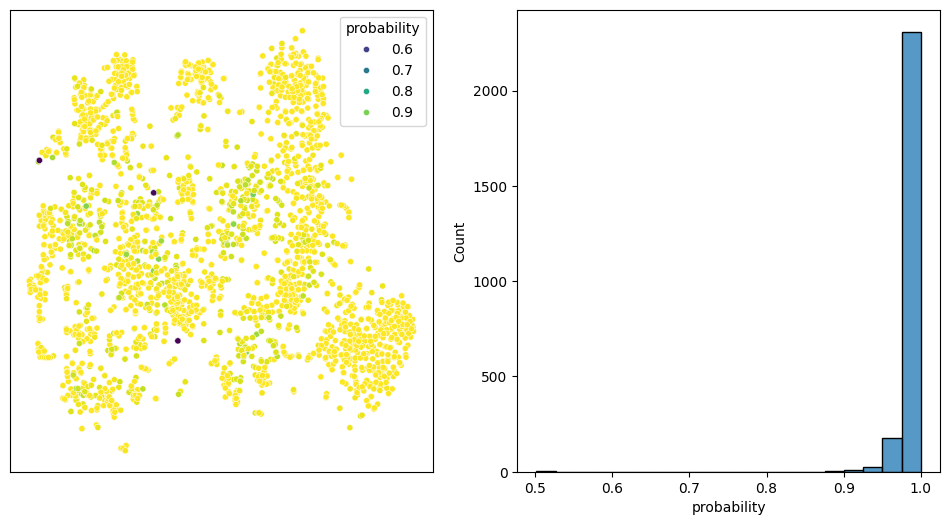

In [8]:
import matplotlib.pyplot as plt
import warnings
from seaborn import histplot
from seaborn import scatterplot

warnings.filterwarnings('ignore', category=FutureWarning, module='seaborn')

plot_df = test_df[['x', 'y']].copy()
plot_df['probability'] = np.max(logreg.predict_proba(X=test_df['value'].apply(func=pd.Series)), axis=1)

plt, ax = plt.subplots(ncols=2, figsize=(12, 6))
scatterplot(ax=ax[0], data=plot_df, x='x', y='y', hue='probability', palette='viridis', s=20)
ax[0].set(xlabel=None)
ax[0].set(ylabel=None)
ax[0].set(xticklabels=[])
ax[0].set(yticklabels=[])
ax[0].tick_params(axis='both', which='both', length=0)
histplot(ax=ax[1], data=plot_df, x='probability', bins=20)

Most of our model probabilities are almost all really high. Yay.